# 2021-2 텍스트마이닝 기말 프로젝트

# import packages

In [3]:
import requests
import time
import re
import pandas as pd
import pprint
import pycrfsuite

import eli5

import numpy as np
import matplotlib.pyplot as plt
import math
import seaborn as sns
import site; site.getsitepackages()

from bs4 import BeautifulSoup

from tensorflow.keras.layers import Embedding, Dense, LSTM
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint

from sklearn.metrics import confusion_matrix, classification_report

from sklearn.naive_bayes import MultinomialNB
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.linear_model import Perceptron
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.neural_network import MLPClassifier

from collections import defaultdict

from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

from sklearn_crfsuite import CRF 
from sklearn.model_selection import cross_val_predict # train_test_split <- 쓰려면 쓰기
from sklearn_crfsuite .metrics import flat_classification_report # metrics: measure(Accuracy, score 등) 도구

from nltk.probability import FreqDist
from pycrfsuite_spacing import TemplateGenerator
from pycrfsuite_spacing import CharacterFeatureTransformer
from pycrfsuite_spacing import sent_to_xy
from bs4 import BeautifulSoup
from konlpy.tag import Kkma as kkm
from konlpy.tag import Okt
import tweepy


# score 정보 -> (원하는 것) 어떤 문장이 몇점인지를 예측 -> 이 값이 평균 이상이면 긍정, 평균 미만이면 부정
#            -> 긍/부정 으로만 학습하면 결과가 더 부정확할 수도. 
#            -> (현행) 평균 이상이면 100, 미만 0으로 분류해서 학습, 적용

# kkm 형태소 분석기에서 사전 조정해서, 칼퇴, 워라밸 같은 우리가 사용하는 단어로 수정하기.
# raw data : 맞춤법 교정.
# 조사 같은 연결어 제외하기. feature 추가(전전단어와 후후단어)
# CRF : N-gram ?????  kkm 사전을 형태소로 나눠놓고 하는 걸로. 

# 긍정/부정 리뷰 스크래핑+키워드 추출+사전으로 추가(feature) 
# 명사(를 비롯한 주요 단어)인 pos tag 만 뽑아서 feature에서 가중치 주기. 
# feature: pos tag에서 규칙 찾아서(eg. NNG+NNG) 여러 단어 연접하여 새롭게 긍/부정어 사전 돌리기 ??? <- 복잡. 
# 쪼개진 긍부정어 사전(만들어진 txt) 찾아보기.

# 조사 없애기? pos tag 포기. 띄어쓰기 교정 + 맞춤법 교정 + CRF ...? 
# feat -1, +1 < 최고로 나쁘다 -> 최고 로 나쁘 다 : 이런 식으로 CRF 특징이 무효화 됨.  

# CRF가 아니라, 다른 방식으로 해보는 게 어떤지? eg. review classification처럼 
# summarization + 빈도수 처리 + .... + N-gram 활용
# 시각화: eli5 

# Web Scraping

In [4]:
# 참고 사이트 https://yeo0.github.io/data/2018/09/24/5.-%EB%A1%9C%EA%B7%B8%EC%9D%B8%EC%9D%B4-%ED%95%84%EC%9A%94%ED%95%9C-%EC%82%AC%EC%9D%B4%ED%8A%B8%EC%97%90%EC%84%9C%EC%9D%98-%ED%81%AC%EB%A1%A4%EB%A7%81/
# 참고 사이트 2 https://hashcode.co.kr/questions/9084/%EC%9E%A1%ED%94%8C%EB%9E%98%EB%8B%9B-%EB%A1%9C%EA%B7%B8%EC%9D%B8-%ED%9B%84-%EC%8A%A4%ED%81%AC%EB%A0%88%EC%9D%B4%ED%95%91-%EB%AC%B8%EC%9D%98%EB%93%9C%EB%A6%BD%EB%8B%88%EB%8B%A4-%E3%85%9C%E3%85%9C

# 로그인 할 url
url = "https://www.jobplanet.co.kr/users/sign_in?_nav=gb"
user_agent = 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/78.0.3904.97 Safari/537.36'
headers = {'Content-type': 'application/json', 'Accept': 'text/plain', 'User-Agent':user_agent}
login_data = {'user':{'email':'hsmy31@hanyang.ac.kr', 'password':'rhkwpgksmswnd!', 'remember_me':'true'}}
session = requests.session()

# 로그인 실행
login_response = session.post(url, json = login_data, headers = headers)

reviews = []

In [7]:
#전체 리뷰 추출

def all_reviews(code):
    url = "https://www.jobplanet.co.kr/reviews?&industry_id=" + str(code)
    response =  session.get(url)
    soup = BeautifulSoup(response.text, 'html.parser')
    num = soup.find('span', class_='num') # 리뷰 개수 확인
    num = int(num.get_text().strip())
    import math, random
    pages = math.ceil(num / 10)
    reviews = {}
    for i in range(pages+1):
        time.sleep(1)
        url = "https://www.jobplanet.co.kr/reviews?&industry_id=" + str(code) + "&page="+ str(i)
        response =  session.get(url)
        soup = BeautifulSoup(response.text, 'html.parser')
        label = soup.find_all('h2', class_="us_label") # 한 줄 리뷰 추출
        # 추출한 리뷰에서 태그를 제외한 텍스트만 추출하여 labels 리스트에 저장
        labels = [label.get_text().strip() for label in label[:]]
        star = soup.find_all('div', class_="star_score") # 별점이 포함된 div 추출
        # 추출한 div에서 별점을 나타내는 width 속성의 숫자로 된 부분을 stars 리스트에 저장
        stars = re.findall('[0-9]+[.]+[0-9]', str(star))
        # reviews 딕셔너리에 '리뷰: 별점' 형식으로 추가
        for j in range(len(labels)):
            reviews[labels[j][5:-1]] = stars[j].replace('.0','')
    return reviews

In [8]:
#전체 리뷰 및 별점 딕셔너리화
codes = ['1001', '900', '704', '1004']
reviews={}

for i in range(0,len(codes)):
    reviews.update(dict(all_reviews(codes[i])))

In [9]:
len(reviews)

2552

In [10]:
# 리스트 형식으로 text와 score 각각 저장
text_all=list(reviews.keys())
score_all=list(reviews.values())

In [11]:
print(len(text_all))
score_all[:10]

2552


['100', '100', '96', '96', '94', '94', '94', '94', '94', '94']

In [12]:
# 전체 리뷰의 평균값 구하기
sum=0
for i in range(len(score_all)):
    sum+=int(score_all[i])
avr_all=sum/len(score_all)
print("score 평균값: ", round(avr_all,3))

score 평균값:  56.194


# 긍정어/부정어사전 만들기

In [13]:
#공통/ 업종별 불용어(자주 나오지만 문서 전체에 관련되어 있어 성능 체크에 의미가 없는 단어들) 선언
stopwords=['있음','기업', '업무', '회사', '직장','분위기','사람','직원','근무']

In [14]:
#긍/부정 리뷰별 빈출단어 추출 및 사전화
#검색 성능을 높이기 위해 문장을 제일 잘게 쪼개는 kkma 사용

kkm=kkm()

text_kkm=[]

#형태소 분석 및 문장별 점수 매칭

for i in range(len(text_all)):
    text_kkm.append(kkm.nouns(text_all[i]))
    text_kkm[i].append(score_all[i])
    
print(text_kkm[:10])

[['대체적', '근무', '환경', '부서', '업무량', '시', '야근', '필요', '경우', '존재', '100'], ['정년', '보장', '도서', '도서대출반납', '대출', '반납', '다양', '프로그램', '운영', '운영중', '중', '100'], ['대한', '대한민국', '민국', '식량', '식량산업', '산업', '최전선', '분투', '해군', '소수', '소수정예', '정예', '종자', '종자관리', '관리', '전문', '전문기관', '기관', '소속', '소속직원', '직원', '대한민국전체', '전체', '200', '200명', '명', '96'], ['수평적', '회사', '회사분위기', '분위기', '상사', '눈치', '안', '안보고', '보고', '휴가', '내가', '일', '외국인', '사람', '저녁', '삶', '가능', '직장', '96'], ['민원인', '업무', '업무강도', '강도', '조사관', '친절', '94'], ['세종', '세종시', '시', '활동', '기업', '기업지원기관', '지원', '기관', '신생', '신생기관', '94'], ['도청', '근무', '충청남', '충청남도', '도', '총괄적', '업무', '수행', '예하', '시', '시군의', '군의', '정책', '그림', '곳', '94'], ['서울', '도심', '국제기구', '국제', '국제현안', '현안', '수', '관련', '커리어', '있음', '94'], ['자유', '분위기', '보수적', '공공', '공공기관', '기관', '생각', '때', '느낌', '유사', '94'], ['노동법', '곳', '직원', '전반적', '함', '악성', '민', '민원인', '원인', '상대', '가나', '있음', '94'], ['워', '워라벨', '라벨', '연봉', '세금', '해외', '지역', '근무', '점', '단점', '힘', '92'], ['근무', '연가', '보', '보수가', '수가

In [15]:
pos_kkm=[]
morphs_kkm=[]
dic_stopwords=stopwords
#연관이 낮아 보이는 형태소와 1글자 음절, 불용어를 제외한 체언, 용언, 관형사, 부사만 뽑아내기

for i in range(len(text_all)):
    pos_kkm.append(kkm.pos(text_all[i]))

dic_kkm=[]

for i in range(len(pos_kkm)):
    dic_kkm.append([])
    for j in range(len(pos_kkm[i])):
        if pos_kkm[i][j][0] not in dic_stopwords:
            if pos_kkm[i][j][1].startswith('N') or pos_kkm[i][j][1].startswith('V')or pos_kkm[i][j][1].startswith('M'):
                dic_kkm[i].append(pos_kkm[i][j][0])
    dic_kkm[i].append(int(score_all[i]))


In [16]:
dic_kkm[:10]

[['대체적',
  '환경',
  '좋',
  '부서',
  '따르',
  '다르',
  '업무량',
  '몰리',
  '시',
  '야근',
  '필요',
  '경우',
  '존재',
  100],
 ['정년',
  '확실히',
  '보장',
  '도서',
  '대출',
  '반납',
  '아니',
  '다양',
  '프로그램',
  '운영',
  '중',
  '이',
  '좋',
  100],
 ['대한민국',
  '식량',
  '산업',
  '최전선',
  '분투',
  '해군',
  '같',
  '소수',
  '정예',
  '종자',
  '관리',
  '전문',
  '기관',
  '소속',
  '대한민국',
  '전체',
  '200',
  '명',
  '없',
  96],
 ['수평적',
  '이',
  '좋',
  '상사',
  '눈치',
  '많이',
  '안',
  '보고',
  '휴가',
  '쓰',
  '내가',
  '하',
  '일',
  '열심히',
  '하',
  '되',
  '외국인',
  '일하',
  '것',
  '좋아하',
  '즐기',
  '저녁',
  '있',
  '삶',
  '가능',
  96],
 ['민원인', '많', '강도', '높', '조사관', '친절', 94],
 ['세종', '시', '활동', '좋', '지원', '기관', '이', '신생', '기관', '이', 94],
 ['도청',
  '충청남도',
  '관하',
  '총괄적',
  '이',
  '수행',
  '되',
  '예하',
  '시',
  '군의',
  '정책',
  '크',
  '그림',
  '그리',
  '곳',
  94],
 ['서울',
  '도심',
  '있',
  '국제기구',
  '국제',
  '현안',
  '다루',
  '수',
  '있',
  '관련',
  '커리어',
  '쌓',
  '수',
  94],
 ['자유', '보수적', '이', '않', '상당히', '공공', '기관', '생각', '때', '느낌', '가장', '유사', 9

In [17]:
# 긍/부정 빈도수 체크하여 상위 50개를 사전으로 저장

dic_text_pos=[]
dic_text_neg=[]  

for i in range(len(dic_kkm)):
    for j in range(0, len(dic_kkm[i])):
        if type(dic_kkm[i][j]) != int:
            if len(dic_kkm[i][j])>1:
                if float(dic_kkm[i][ -1]) > avr_all:
                    dic_text_pos.append(dic_kkm[i][j])
                else:
                    dic_text_neg.append(dic_kkm[i][j])

fdist1=FreqDist(dic_text_pos)
dic_text_pos=fdist1.most_common(100)

fdist1=FreqDist(dic_text_neg)
dic_text_neg=fdist1.most_common(100)

In [18]:
dic_text_pos1=[]
dic_text_neg1=[]

for i in range(len(dic_text_pos)):
    dic_text_pos1.append(dic_text_pos[i][0])
    
for i in range(len(dic_text_neg)):
    dic_text_neg1.append(dic_text_neg[i][0])

print(dic_text_pos1)
print(dic_text_neg1)

['일하', '다니', '경험', '다양', '배우', '문화', '복지', '기관', '환경', '생각', '가지', '성장', '편하', '추천', '연봉', '대하', '안정적', '많이', '아니', '가능', '공무원', '공공', '최고', '발전', '계약', '조직', '자유', '급여', '괜찮', '대우', '공기업', '강도', '나쁘', '매우', '업계', '여러', '시간', '힘들', '하지만', '사업', '보장', '수평적', '따르', '개발', '본인', '경력', '금융', '부서', '없이', '자기', '비하', '노력', '생활', '너무', '장점', '투자', '커리어', '사회', '위하', '신입', '은행', '다르', '보수적', '그냥', '함께', '정도', '다른', '수준', '기회', '만족', '보이', '능력', '성과', '만큼', '전반적', '체계', '월급', '외국계', '야근', '이상', '느끼', '때문', '개인', '사내', '운영', '지원', '다만', '하나', '가능성', '규모', '인턴', '정규직', '빠르', '눈치', '느낌', '지역', '그러', '한국', '안정성', '관심']
['일하', '다니', '배우', '추천', '생각', '문화', '다양', '복지', '힘들', '너무', '기관', '경력', '아니', '경험', '연봉', '많이', '신입', '대하', '체계', '급여', '사무실', '괜찮', '그냥', '자유', '나쁘', '대표', '환경', '발전', '성장', '매우', '편하', '위하', '모르', '못하', '개인', '시간', '다르', '따르', '가지', '안정적', '바뀌', '가능', '이상', '야근', '별로', '사업', '업계', '입사', '공공', '계약', '운영', '보험', '회계', '최악', '금융', '보수적', '본인', '조직', '오래', '자기', '하나', '대우', '은행', '퇴사',

# 데이터 전처리

In [19]:
sent_num=0
text_sent=[]

for i in range(len(text_all)):
    text_pos=kkm.pos(text_all[i])
    sent_num+=1
    for t in text_pos:
        n=list(t)
        n.insert(0, "Sentence: {}".format(sent_num))
        if float(score_all[(sent_num-1)]) > avr_all:
            n.insert(3, '100')
        else: 
            n.insert(3, '0')        
        text_sent.append(n)

In [20]:
len(text_sent)

63175

In [21]:
# 불용어 처리 전 token 빈도 수 확인
words=[]
for t in text_sent :
    words.append(t[1])

In [22]:
# 단어 사전 만들기 (key : value = word : 빈도 수)
words_dict = {} # 
for word in words:
    if word in words_dict:
        words_dict[word] += 1
    else:
        words_dict[word] = 1

In [23]:
sort_dict = sorted(words_dict.items(), key=lambda x: x[1], reverse=True)    

In [24]:
pprint.pprint(sort_dict)

[('하', 2552),
 ('이', 2453),
 ('는', 2050),
 ('.', 1793),
 ('ㄴ', 1659),
 ('은', 1259),
 ('고', 1169),
 ('있', 1048),
 ('ㄹ', 979),
 ('을', 971),
 ('가', 871),
 ('회사', 777),
 ('에', 737),
 ('좋', 694),
 ('수', 693),
 (',', 649),
 ('어', 602),
 ('들', 567),
 ('의', 561),
 ('곳', 555),
 ('다', 528),
 ('음', 495),
 ('ㅁ', 459),
 ('도', 457),
 ('지', 452),
 ('를', 432),
 ('으로', 425),
 ('업무', 390),
 ('없', 373),
 ('사람', 364),
 ('되', 347),
 ('게', 346),
 ('기', 336),
 ('않', 321),
 ('많', 313),
 ('일', 306),
 ('것', 304),
 ('었', 301),
 ('ㅂ니다', 287),
 ('지만', 280),
 ('일하', 270),
 ('분위기', 262),
 ('에서', 260),
 ('과', 254),
 ('면', 252),
 ('기업', 243),
 ('직원', 238),
 ('로', 230),
 ('만', 228),
 ('다니', 218),
 ('아', 215),
 ('습니다', 196),
 ('있음', 190),
 ('배우', 173),
 ('보', 165),
 ('며', 163),
 ('나', 153),
 ('경험', 153),
 ('근무', 151),
 ('다양', 148),
 ('문화', 146),
 ('생각', 144),
 ('싶', 143),
 ('추천', 142),
 ('같', 135),
 ('복지', 134),
 ('라', 131),
 ('어서', 130),
 ('주', 129),
 ('기관', 128),
 ('와', 128),
 ('에게', 128),
 ('잘', 125),
 ('으나', 124),
 

 ('무기', 7),
 ('스마트', 7),
 ('입장', 7),
 (':', 7),
 ('주변', 7),
 ('진급', 7),
 ('ㄴ가', 7),
 ('더라도', 7),
 ('신분', 7),
 ('향상', 7),
 ('파악', 7),
 ('그나마', 7),
 ('간의', 7),
 ('눈치보', 7),
 ('짧', 7),
 ('맞추', 7),
 ('사기업', 7),
 ('전문적', 7),
 ('편히', 7),
 ('선', 7),
 ('어쩌', 7),
 ('초봉', 7),
 ('지내', 7),
 ('정보', 7),
 ('계열', 7),
 ('조정', 7),
 ('지인', 7),
 ('는다면', 7),
 ('상담', 7),
 ('실', 7),
 ('신', 7),
 ('단체', 7),
 ('돌', 7),
 ('누리', 7),
 ('쌓이', 7),
 ('인간', 7),
 ('경직', 7),
 ('신규', 7),
 ('이렇', 7),
 ('예술', 7),
 ('해결', 7),
 ('잇', 7),
 ('가족적', 7),
 ('보통', 7),
 ('파트', 7),
 ('이런', 7),
 ('준비', 7),
 ('싫', 7),
 ('원활', 7),
 ('군대식', 7),
 ('소', 7),
 ('깔끔', 7),
 ('애매', 7),
 ('…', 7),
 ('각', 7),
 ('인정', 7),
 ('메', 7),
 ('펀드', 7),
 ('벤처', 7),
 ('전부', 7),
 ('접하', 7),
 ('딱히', 7),
 ('특정', 7),
 ('책임감', 7),
 ('네', 7),
 ('밑', 7),
 ('달라지', 7),
 ('복리', 7),
 ('후생', 7),
 ('일과', 7),
 ('여신', 7),
 ('도전', 7),
 ('현', 7),
 ('무슨', 7),
 ('잡일', 7),
 ('소수', 6),
 ('밖에', 6),
 ('신생', 6),
 ('그리', 6),
 ('다루', 6),
 ('유연', 6),
 ('스', 6),
 ('덜', 6),
 ('매년', 6)

 ('국책', 2),
 ('고학력', 2),
 ('쏟아지', 2),
 ('내세우', 2),
 ('모자라', 2),
 ('부조리', 2),
 ('평온', 2),
 ('.........', 2),
 ('충실', 2),
 ('가르치', 2),
 ('군포', 2),
 ('주차장', 2),
 ('상가', 2),
 ('원주', 2),
 ('안동', 2),
 ('가치관', 2),
 ('밥통', 2),
 ('미국', 2),
 ('대략', 2),
 ('중이', 2),
 ('놓치', 2),
 ('으려고', 2),
 ('이에', 2),
 ('연장', 2),
 ('동', 2),
 ('식물', 2),
 ('맛', 2),
 ('평화', 2),
 ('환경부', 2),
 ('별개', 2),
 ('약하', 2),
 ('국회', 2),
 ('최상위', 2),
 ('시야', 2),
 ('챙겨주', 2),
 ('읃', 2),
 ('돕', 2),
 ('주심', 2),
 ('노동자', 2),
 ('권리', 2),
 ('관광', 2),
 ('준하', 2),
 ('확보', 2),
 ('제주도', 2),
 ('직업', 2),
 ('ㄹ까', 2),
 ('기술직', 2),
 ('운동', 2),
 ('진상', 2),
 ('엑스', 2),
 ('던', 2),
 ('관리인', 2),
 ('증원', 2),
 ('식품', 2),
 ('공정', 2),
 ('거래', 2),
 ('이력', 2),
 ('준공', 2),
 ('헐', 2),
 ('창원', 2),
 ('농업', 2),
 ('인도', 2),
 ('높이', 2),
 ('훨씬', 2),
 ('발달', 2),
 ('보건', 2),
 ('충족', 2),
 ('표본', 2),
 ('일본인', 2),
 ('기성세대', 2),
 ('감축', 2),
 ('여유있', 2),
 ('둘', 2),
 ('전전', 2),
 ('거치', 2),
 ('직임', 2),
 ('기독교인', 2),
 ('려면', 2),
 ('커피', 2),
 ('세상', 2),
 ('광역시', 2),
 ('옮겨

 ('천', 1),
 ('자유시간', 1),
 ('소화', 1),
 ('소진', 1),
 ('행정원', 1),
 ('면도', 1),
 ('유명', 1),
 ('도박장', 1),
 ('꺼리', 1),
 ('부서냐', 1),
 ('간접적', 1),
 ('충청북도', 1),
 ('진천군', 1),
 ('광혜원면', 1),
 ('기상청', 1),
 ('소송', 1),
 ('삼중고', 1),
 ('찍히', 1),
 ('따라다니', 1),
 ('직간', 1),
 ('유리벽', 1),
 ('가정과', 1),
 ('수목원', 1),
 ('띄', 1),
 ('But', 1),
 ('농촌', 1),
 ('경찰서', 1),
 ('넘어오', 1),
 ('게이트', 1),
 ('투', 1),
 ('톱', 1),
 ('전입', 1),
 ('다가오', 1),
 ('탈출', 1),
 ('청사', 1),
 ('조직성', 1),
 ('타지역', 1),
 ('소문', 1),
 ('대외적', 1),
 ('역사가', 1),
 ('한명', 1),
 ('궁리', 1),
 ('동등', 1),
 ('심해', 1),
 ('강동구', 1),
 ('독려', 1),
 ('일종', 1),
 ('경쟁률', 1),
 ('다치', 1),
 ('변두리', 1),
 ('노원구', 1),
 ('합리성', 1),
 ('껍데기', 1),
 ('미술관', 1),
 ('관람객', 1),
 ('스탭', 1),
 ('총괄', 1),
 ('팍팍', 1),
 ('ㅂ니까', 1),
 ('ㅁ다만', 1),
 ('일반직', 1),
 ('체육회', 1),
 ('못받는', 1),
 ('무르', 1),
 ('창작', 1),
 ('공연', 1),
 ('진로', 1),
 ('대잔치', 1),
 ('일상인', 1),
 ('타군', 1),
 ('제각각', 1),
 ('핫', 1),
 ('OK', 1),
 ('예술가', 1),
 ('않는', 1),
 ('볼', 1),
 ('직영', 1),
 ('통일', 1),
 ('허울', 1),
 ('장이', 1),
 (

 ('허송', 1),
 ('세월', 1),
 ('한정', 1),
 ('GSM', 1),
 ('CDMA', 1),
 ('양쪽', 1),
 ('았어도', 1),
 ('충원', 1),
 ('동아리', 1),
 ('번지르르', 1),
 ('실재', 1),
 ('선행', 1),
 ('모듈', 1),
 ('국비', 1),
 ('결과적', 1),
 ('주도적', 1),
 ('뿔', 1),
 ('제외지', 1),
 ('특근', 1),
 ('프로', 1),
 ('내공', 1),
 ('죄다', 1),
 ('제휴', 1),
 ('빌붙', 1),
 ('무지막지', 1),
 ('승승장구', 1),
 ('흠', 1),
 ('어쩐지', 1),
 ('안정면', 1),
 ('짜르', 1),
 ('무원', 1),
 ('기서', 1),
 ('막막', 1),
 ('하하', 1),
 ('통제', 1),
 ('불친절', 1),
 ('매주', 1),
 ('제약', 1),
 ('원수라', 1),
 ('SDS', 1),
 ('무서', 1),
 ('저조', 1),
 ('간식', 1),
 ('정수', 1),
 ('it', 1),
 ('van', 1),
 ('직원도', 1),
 ('강압적', 1),
 ('이거', 1),
 ('OS', 1),
 ('MW', 1),
 ('아이티', 1),
 ('따라', 1),
 ('si', 1),
 ('더럽', 1),
 ('태광', 1),
 ('스프린트', 1),
 ('동정', 1),
 ('밴', 1),
 ('적자', 1),
 ('나지', 1),
 ('유대감', 1),
 ('주도성', 1),
 ('발하', 1),
 ('철수', 1),
 ('리트', 1),
 ('50', 1),
 ('스웨덴', 1),
 ('에릭슨', 1),
 ('전자', 1),
 ('정비', 1),
 ('드러나', 1),
 ('엘', 1),
 ('감시카메라', 1),
 ('휴식', 1),
 ('얽매이', 1),
 ('많운', 1),
 ('금액', 1),
 ('소비', 1),
 ('개꿀', 1),
 ('KT', 1)

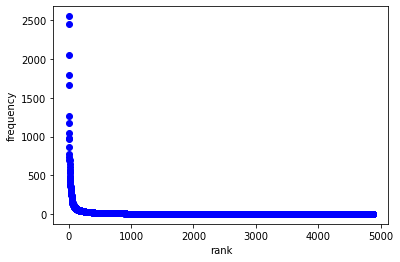

In [25]:
rank=0

for k, v in sort_dict:
    rank+=1
    plt.plot(rank, words_dict[k], 'bo')
plt.xlabel('rank')
plt.ylabel('frequency')
plt.show()

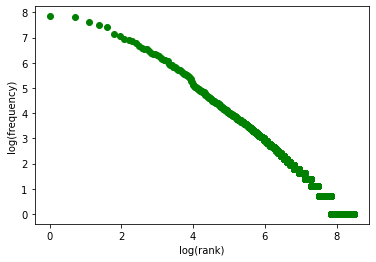

In [26]:
rank=0
for k, v in sort_dict:
    rank+=1
    plt.plot(math.log(rank), math.log(v), 'go')
plt.xlabel('log(rank)')
plt.ylabel('log(frequency)')
plt.show()

In [27]:
text_del_SW = [] # POS(조사, 특수문자, 접사) 제거

for t in text_sent : 
    if ( (t[2][0] !='E') & (t[2][0] !='J') & (t[2][0] !='S') ):
        text_del_SW.append(t)

In [28]:
# (수동)불용어 사전 만들기
stopwords2=['하', '수', '있', '이','것', '되', '등', '적', '들', '성', '일', '보', '롭', '주']
text_del_SW2 = []
for t in text_del_SW: 
    if t[1] not in stopwords2:
        text_del_SW2.append(t)

In [29]:
text_del_SW2[:10]

[['Sentence: 1', '대체적', 'NNG', '100'],
 ['Sentence: 1', '근무', 'NNG', '100'],
 ['Sentence: 1', '환경', 'NNG', '100'],
 ['Sentence: 1', '좋', 'VA', '100'],
 ['Sentence: 1', '부서', 'NNG', '100'],
 ['Sentence: 1', '따르', 'VV', '100'],
 ['Sentence: 1', '다르', 'VV', '100'],
 ['Sentence: 1', '업무량', 'NNG', '100'],
 ['Sentence: 1', '몰리', 'VV', '100'],
 ['Sentence: 1', '시', 'NNG', '100']]

In [30]:
len(text_sent) # 불용어 처리 전 token 수

63175

In [31]:
len(text_del_SW2) # 불용어 처리 후 token 수

31041

In [32]:
# dictionary(word: freq) return 함수 만들고 싶은데 실패함
'''
def words_dict(sent_in):
    words=[]
    for t in sent_in :
        words.append(t[1])
        
    words_dict = {}
    for word in words
        if word in words_dict:
            words_dict[word] += 1
        else:
            words_dict[word] = 1
    return words_dict
'''

'\ndef words_dict(sent_in):\n    words=[]\n    for t in sent_in :\n        words.append(t[1])\n        \n    words_dict = {}\n    for word in words\n        if word in words_dict:\n            words_dict[word] += 1\n        else:\n            words_dict[word] = 1\n    return words_dict\n'

In [33]:
words=[]
for t in text_del_SW2 :
    words.append(t[1])
        

In [34]:
# 단어 사전 만들기 (key : value = word : 빈도 수)
words_dict = {} # 
for word in words:
    if word in words_dict:
        words_dict[word] += 1
    else:
        words_dict[word] = 1

In [35]:
pprint.pprint(words_dict)

{'0': 3,
 '00': 4,
 '1': 64,
 '10': 9,
 '100': 10,
 '11': 1,
 '130': 1,
 '15': 4,
 '16,000': 1,
 '18': 1,
 '2': 21,
 '20': 10,
 '200': 1,
 '2021': 1,
 '2023': 1,
 '21': 2,
 '3': 18,
 '30': 8,
 '300': 2,
 '33': 1,
 '4': 11,
 '4-5': 1,
 '40': 3,
 '45': 1,
 '5': 15,
 '5-6': 1,
 '50': 1,
 '6': 5,
 '680': 1,
 '7': 3,
 '70-80': 1,
 '8': 6,
 '80': 4,
 '9': 6,
 '90': 3,
 '92': 1,
 'A': 4,
 'ABL': 1,
 'AC': 1,
 'AXA': 1,
 'B': 3,
 'BB': 1,
 'BNP': 1,
 'BNPParibas': 1,
 'Balance': 1,
 'Banking': 1,
 'But': 1,
 'CDMA': 1,
 'CEO': 2,
 'CIB': 1,
 'CJ': 1,
 'Capital': 1,
 'Co': 1,
 'DB': 2,
 'Dog': 1,
 'ERP': 2,
 'English': 1,
 'Equity': 1,
 'Ex': 1,
 'FC': 1,
 'G': 1,
 'GA': 2,
 'GSM': 1,
 'Global': 1,
 'I': 1,
 'ICT': 1,
 'IFC': 1,
 'IOT': 2,
 'IP': 1,
 'IT': 13,
 'Investment': 1,
 'It': 1,
 'KB': 1,
 'KT': 1,
 'LG': 4,
 'Lg': 1,
 'Life': 1,
 'M': 1,
 'MW': 1,
 'NHN': 1,
 'New': 1,
 'No': 1,
 'ODM': 1,
 'OK': 1,
 'OS': 1,
 'P': 2,
 'PF': 1,
 'PG': 1,
 'PM': 1,
 'Private': 1,
 'SDS': 1,
 'SI': 3,
 

 '데시': 1,
 '데이터': 1,
 '도': 8,
 '도가': 2,
 '도래': 1,
 '도로': 6,
 '도망가': 1,
 '도망치': 3,
 '도맡': 1,
 '도매': 1,
 '도면': 2,
 '도모': 2,
 '도박장': 1,
 '도보': 1,
 '도사': 1,
 '도서': 5,
 '도서관': 6,
 '도시': 5,
 '도시락': 3,
 '도시인': 1,
 '도심': 1,
 '도와주': 4,
 '도움': 22,
 '도입': 1,
 '도전': 7,
 '도청': 2,
 '도태': 3,
 '도통': 1,
 '독': 1,
 '독단적': 1,
 '독려': 1,
 '독립': 4,
 '독립적': 1,
 '독보적': 1,
 '독서실': 1,
 '독자성': 1,
 '독재': 3,
 '독점': 2,
 '독특': 1,
 '돈': 44,
 '돈독': 1,
 '돋보이': 1,
 '돌': 7,
 '돌려받': 1,
 '돌아가': 15,
 '돌아보': 2,
 '돌이켜보': 1,
 '돔': 1,
 '돕': 2,
 '동': 2,
 '동결': 1,
 '동등': 1,
 '동떨어지': 2,
 '동료': 16,
 '동물': 1,
 '동부': 2,
 '동생': 1,
 '동시': 6,
 '동아리': 1,
 '동안': 12,
 '동의': 1,
 '동일': 1,
 '동정': 1,
 '동조': 1,
 '동종': 19,
 '돼': 2,
 '되게': 1,
 '되기': 1,
 '되돌아보': 1,
 '된': 1,
 '두': 11,
 '두개': 1,
 '두고': 1,
 '두드러지': 1,
 '두렵': 1,
 '두루': 5,
 '두서없': 1,
 '두어': 1,
 '둔산동': 1,
 '둘': 2,
 '둘러앉': 1,
 '둥': 2,
 '둥글둥글': 1,
 '뒤': 6,
 '뒤늦': 1,
 '뒤떨어지': 1,
 '뒤엎': 1,
 '뒤집': 1,
 '뒤쳐지': 1,
 '뒷': 1,
 '뒷담': 3,
 '뒷받침': 1,
 '뒷전': 1,
 '드': 15,
 '드러나': 1,
 '드리': 9,
 '드림': 1,
 

 '상생': 1,
 '상쇄': 1,
 '상승': 5,
 '상승률': 3,
 '상식': 2,
 '상여': 1,
 '상여금': 1,
 '상위': 6,
 '상위권': 8,
 '상은': 1,
 '상의': 1,
 '상이': 3,
 '상임': 2,
 '상장': 1,
 '상주': 2,
 '상처': 1,
 '상태': 4,
 '상품': 5,
 '상하': 6,
 '상호': 2,
 '상황': 11,
 '새': 6,
 '새내기': 1,
 '새로': 2,
 '새로이': 1,
 '새롭': 12,
 '새마을': 1,
 '새벽': 2,
 '색': 2,
 '색깔': 1,
 '색다르': 1,
 '생': 8,
 '생가': 1,
 '생각': 144,
 '생각나': 1,
 '생기': 11,
 '생명': 4,
 '생보사': 1,
 '생성': 1,
 '생일': 1,
 '생활': 40,
 '샵': 1,
 '서': 3,
 '서관': 1,
 '서기': 1,
 '서기관': 1,
 '서도': 2,
 '서로': 21,
 '서류': 5,
 '서면': 1,
 '서무': 1,
 '서민': 1,
 '서버': 2,
 '서비스': 22,
 '서서': 2,
 '서슴없이': 1,
 '서열': 2,
 '서운': 1,
 '서울': 22,
 '서울시': 5,
 '서울지점': 1,
 '석': 1,
 '석박': 1,
 '석사': 3,
 '섞이': 2,
 '선': 7,
 '선거': 3,
 '선거철': 2,
 '선단': 1,
 '선도': 1,
 '선도자': 1,
 '선두': 1,
 '선망': 1,
 '선물': 2,
 '선배': 3,
 '선임': 2,
 '선진국': 1,
 '선진적': 1,
 '선진화': 1,
 '선택': 8,
 '선하': 1,
 '선행': 1,
 '선호': 1,
 '선후배': 1,
 '설계': 2,
 '설계사': 9,
 '설립': 2,
 '설명': 5,
 '설치': 2,
 '섬': 1,
 '성격': 10,
 '성골': 1,
 '성공': 3,
 '성공적': 1,
 '성공할려': 1,
 '성과': 29,
 '성과급': 6,


 '웠으뮤ㅠ': 1,
 '웨': 1,
 '웬만': 1,
 '위': 38,
 '위계': 2,
 '위계질서': 3,
 '위권': 3,
 '위급': 2,
 '위기': 5,
 '위상': 2,
 '위생사': 1,
 '위성': 2,
 '위원': 1,
 '위의': 2,
 '위주': 10,
 '위쪽': 1,
 '위축': 1,
 '위치': 38,
 '위탁': 2,
 '위태': 2,
 '위하': 57,
 '윈': 1,
 '윗': 11,
 '윗물': 2,
 '윗사람': 10,
 '유': 9,
 '유관': 1,
 '유급': 1,
 '유니': 1,
 '유대': 2,
 '유대감': 1,
 '유독': 1,
 '유동적': 1,
 '유동화': 1,
 '유럽': 1,
 '유리': 1,
 '유리벽': 1,
 '유망': 2,
 '유명': 1,
 '유사': 1,
 '유산': 1,
 '유엔': 1,
 '유연': 6,
 '유일': 10,
 '유일한': 1,
 '유지': 16,
 '유지가': 1,
 '유출': 1,
 '유치': 1,
 '유통': 1,
 '유페이먼트': 1,
 '유하': 1,
 '유학생': 1,
 '유행성': 1,
 '유효': 1,
 '육': 1,
 '육군': 1,
 '육성': 2,
 '육아': 5,
 '율': 11,
 '융통성': 2,
 '융화': 1,
 '으': 2,
 '으르렁대': 1,
 '으샤으샤해': 1,
 '으쌰으쌰하': 1,
 '으쌰으쌰하려다가': 1,
 '윽': 1,
 '은': 5,
 '은근': 1,
 '은근히': 1,
 '은퇴': 2,
 '은행': 48,
 '은행권': 4,
 '은행업': 1,
 '은행원': 3,
 '읃': 2,
 '을': 4,
 '을리': 1,
 '음': 11,
 '음식': 1,
 '음식점': 1,
 '응대': 5,
 '응시': 1,
 '응원': 1,
 '의': 5,
 '의견': 5,
 '의논': 1,
 '의뢰': 1,
 '의료': 1,
 '의무': 2,
 '의문': 5,
 '의미': 9,
 '의사': 10,
 '의사소통': 4,
 '의식': 3,
 '의

 '창구': 2,
 '창대': 1,
 '창립': 1,
 '창업': 5,
 '창원': 2,
 '창원시': 1,
 '창작': 1,
 '창조': 1,
 '창출': 1,
 '찾': 16,
 '찾아가': 2,
 '찾아보': 2,
 '채': 3,
 '채권': 6,
 '채무': 2,
 '채용': 11,
 '채우': 8,
 '채택': 1,
 '책': 1,
 '책임': 11,
 '책임감': 7,
 '책임자': 1,
 '책임지': 2,
 '챙': 2,
 '챙겨주': 2,
 '챙기': 15,
 '챠': 1,
 '처리': 10,
 '처우': 10,
 '처음': 26,
 '처하': 1,
 '척': 5,
 '척하': 1,
 '천': 1,
 '천국': 3,
 '천문': 1,
 '천차만별': 4,
 '천천히': 1,
 '철': 5,
 '철수': 1,
 '철저': 6,
 '철저히': 2,
 '첫': 15,
 '첫날': 1,
 '첫발': 1,
 '청': 6,
 '청년': 3,
 '청바지': 2,
 '청사': 1,
 '청소년': 13,
 '청의': 2,
 '청정기': 1,
 '청호': 1,
 '체': 1,
 '체감': 1,
 '체계': 63,
 '체계적': 21,
 '체력': 1,
 '체불': 2,
 '체육': 6,
 '체육회': 1,
 '체인': 1,
 '체질': 1,
 '체크리스트': 1,
 '체험': 2,
 '쳐내': 1,
 '초기': 2,
 '초년': 1,
 '초년생': 8,
 '초반': 4,
 '초보자': 6,
 '초봉': 7,
 '초월': 1,
 '총괄': 1,
 '총괄적': 1,
 '총무': 1,
 '총영사': 2,
 '최': 2,
 '최강': 1,
 '최고': 61,
 '최고급': 1,
 '최근': 9,
 '최대': 4,
 '최대치': 1,
 '최대한': 1,
 '최상': 5,
 '최상위': 2,
 '최소': 2,
 '최소한': 3,
 '최악': 29,
 '최저': 6,
 '최적': 3,
 '최적화': 1,
 '최전선': 2,
 '최종적': 1,
 '최초': 4,
 '최하위': 

In [36]:
pprint.pprint(sorted(words_dict.items(), key=lambda item: item[1], reverse=True))

[('회사', 777),
 ('좋', 694),
 ('곳', 555),
 ('업무', 390),
 ('없', 373),
 ('사람', 364),
 ('않', 321),
 ('많', 313),
 ('일하', 270),
 ('분위기', 262),
 ('기업', 243),
 ('직원', 238),
 ('다니', 218),
 ('있음', 190),
 ('배우', 173),
 ('경험', 153),
 ('근무', 151),
 ('다양', 148),
 ('문화', 146),
 ('생각', 144),
 ('싶', 143),
 ('추천', 142),
 ('같', 135),
 ('복지', 134),
 ('기관', 128),
 ('잘', 125),
 ('편', 121),
 ('직장', 114),
 ('연봉', 110),
 ('받', 107),
 ('크', 105),
 ('환경', 103),
 ('아니', 102),
 ('많이', 101),
 ('안', 101),
 ('성장', 98),
 ('대하', 98),
 ('분', 97),
 ('편하', 96),
 ('가지', 94),
 ('다', 93),
 ('높', 90),
 ('힘들', 90),
 ('직', 89),
 ('쌓', 88),
 ('안정적', 85),
 ('경력', 83),
 ('중', 82),
 ('급여', 82),
 ('및', 80),
 ('너무', 80),
 ('괜찮', 80),
 ('자유', 79),
 ('발전', 79),
 ('그', 79),
 ('가능', 78),
 ('공공', 74),
 ('나쁘', 74),
 ('매우', 71),
 ('계약', 70),
 ('신입', 69),
 ('조직', 69),
 ('시간', 68),
 ('지', 66),
 ('내', 65),
 ('점', 65),
 ('공무원', 65),
 ('대우', 65),
 ('업계', 65),
 ('1', 64),
 ('체계', 63),
 ('가', 63),
 ('임', 62),
 ('팀', 62),
 ('거', 62),
 ('따르', 61),
 (

 ('합리적', 6),
 ('내용', 6),
 ('닿', 6),
 ('단', 6),
 ('협력', 6),
 ('보임', 6),
 ('희망', 6),
 ('담당자', 6),
 ('예전', 6),
 ('누구', 6),
 ('청', 6),
 ('기다리', 6),
 ('쾌적', 6),
 ('열악', 6),
 ('적절', 6),
 ('의욕', 6),
 ('아이', 6),
 ('초보자', 6),
 ('볼만', 6),
 ('도로', 6),
 ('망하', 6),
 ('무능', 6),
 ('의하', 6),
 ('모습', 6),
 ('당시', 6),
 ('물', 6),
 ('부장', 6),
 ('견디', 6),
 ('기억', 6),
 ('개월', 6),
 ('상위', 6),
 ('탈', 6),
 ('고생', 6),
 ('시작하', 6),
 ('그대로', 6),
 ('권한', 6),
 ('파견', 6),
 ('8', 6),
 ('자랑', 6),
 ('뒤', 6),
 ('느', 6),
 ('이루', 6),
 ('불필요', 6),
 ('이사', 6),
 ('말하', 6),
 ('안주', 6),
 ('제대', 6),
 ('임원진', 6),
 ('늘리', 6),
 ('늦', 6),
 ('원수', 6),
 ('대로', 6),
 ('경제', 6),
 ('지나', 6),
 ('확장', 6),
 ('끼리', 6),
 ('향후', 6),
 ('장비', 6),
 ('전산', 6),
 ('성과급', 6),
 ('인센티브', 6),
 ('커뮤니케이션', 6),
 ('하기', 6),
 ('신탁', 6),
 ('주고', 6),
 ('사장님', 6),
 ('밝', 6),
 ('브랜드', 6),
 ('채권', 6),
 ('그래서', 6),
 ('당연', 6),
 ('수도', 6),
 ('결과', 6),
 ('소리', 6),
 ('제발', 6),
 ('그만두', 6),
 ('막', 6),
 ('인수인계', 6),
 ('아무것', 6),
 ('망', 6),
 ('플러스', 6),
 ('몰리', 5),
 ('도서

 ('리스트', 3),
 ('공존', 3),
 ('소프트웨어', 3),
 ('성공', 3),
 ('잡무', 3),
 ('투자자', 3),
 ('보증', 3),
 ('하위권', 3),
 ('러', 3),
 ('입지', 3),
 ('사회적', 3),
 ('잘만', 3),
 ('보기', 3),
 ('자르', 3),
 ('아웃', 3),
 ('사지', 3),
 ('제조업', 3),
 ('요구', 3),
 ('여타', 3),
 ('욕설', 3),
 ('재직', 3),
 ('대형', 3),
 ('고루', 3),
 ('리지', 3),
 ('단계', 3),
 ('인천', 3),
 ('준법', 3),
 ('메뉴', 3),
 ('얼', 3),
 ('혼란', 3),
 ('셋', 3),
 ('주인', 3),
 ('벋', 3),
 ('SK', 3),
 ('불가능', 3),
 ('업력', 3),
 ('협동조합', 3),
 ('운', 3),
 ('B', 3),
 ('파트너', 3),
 ('닫', 3),
 ('꾸준', 3),
 ('지향', 3),
 ('신협', 3),
 ('다지', 3),
 ('7', 3),
 ('리스크', 3),
 ('신한', 3),
 ('분리', 3),
 ('크기', 3),
 ('꽉', 3),
 ('변', 3),
 ('수입', 3),
 ('올라오', 3),
 ('여전히', 3),
 ('낙후', 3),
 ('무겁', 3),
 ('리스', 3),
 ('하여', 3),
 ('분담', 3),
 ('글', 3),
 ('변경', 3),
 ('회의', 3),
 ('치열', 3),
 ('서', 3),
 ('차장', 3),
 ('따뜻', 3),
 ('인맥', 3),
 ('강철', 3),
 ('진취적', 3),
 ('수수료', 3),
 ('이사장', 3),
 ('확', 3),
 ('타사', 3),
 ('하위', 3),
 ('측면', 3),
 ('판단', 3),
 ('전통적', 3),
 ('and', 3),
 ('하루하루', 3),
 ('과거', 3),
 ('편차', 3),
 ('턴', 

 ('그램', 1),
 ('축산물', 1),
 ('통틀', 1),
 ('어쩧', 1),
 ('유니', 1),
 ('크한', 1),
 ('출동', 1),
 ('출장비', 1),
 ('지역적', 1),
 ('지연', 1),
 ('학연', 1),
 ('중점적', 1),
 ('근무제', 1),
 ('산업과', 1),
 ('ceo', 1),
 ('공연장', 1),
 ('선진화', 1),
 ('땅', 1),
 ('책', 1),
 ('저렴', 1),
 ('쟤', 1),
 ('최대치', 1),
 ('끌어올리', 1),
 ('한일', 1),
 ('따박따박', 1),
 ('스포', 1),
 ('파크', 1),
 ('저물', 1),
 ('태양', 1),
 ('많았지만', 1),
 ('똑같이', 1),
 ('회식비', 1),
 ('질리', 1),
 ('130', 1),
 ('시원', 1),
 ('박살', 1),
 ('다하나', 1),
 ('일산', 1),
 ('경남', 1),
 ('베풀', 1),
 ('무상', 1),
 ('원조', 1),
 ('종합적', 1),
 ('YWCA', 1),
 ('간사', 1),
 ('음식점', 1),
 ('스케일', 1),
 ('공짜', 1),
 ('그린', 1),
 ('뉴딜', 1),
 ('실천', 1),
 ('여기저기', 1),
 ('상쇄', 1),
 ('로드', 1),
 ('한정적', 1),
 ('존속', 1),
 ('교육청', 1),
 ('부설', 1),
 ('덕', 1),
 ('꼬박', 1),
 ('부여받', 1),
 ('우체국', 1),
 ('못쓰', 1),
 ('주최', 1),
 ('백', 1),
 ('작살나', 1),
 ('타시', 1),
 ('서민', 1),
 ('감면', 1),
 ('소액', 1),
 ('정책적', 1),
 ('도맡', 1),
 ('가림', 1),
 ('X', 1),
 ('대표부', 1),
 ('태극', 1),
 ('마크', 1),
 ('경제적', 1),
 ('뼛속', 1),
 ('밀접', 1),
 ('무형', 1),

 ('즐거우', 1),
 ('일거리', 1),
 ('신영', 1),
 ('폐쇄', 1),
 ('가보', 1),
 ('바치', 1),
 ('적극', 1),
 ('책임자', 1),
 ('중형', 1),
 ('outlier', 1),
 ('와의', 1),
 ('멘토링', 1),
 ('M', 1),
 ('전략', 1),
 ('쏘쏘', 1),
 ('증권업', 1),
 ('워낙', 1),
 ('끝내', 1),
 ('항', 1),
 ('Private', 1),
 ('Equity', 1),
 ('Venture', 1),
 ('Capital', 1),
 ('역사', 1),
 ('조용조용', 1),
 ('봉', 1),
 ('ㅊ', 1),
 ('긴장', 1),
 ('온순', 1),
 ('유럽', 1),
 ('BNPParibas', 1),
 ('프랑스', 1),
 ('분이라면', 1),
 ('전하', 1),
 ('긷', 1),
 ('라기', 1),
 ('It', 1),
 ('can', 1),
 ('be', 1),
 ('good', 1),
 ('if', 1),
 ('not', 1),
 ('comfortable', 1),
 ('speaking', 1),
 ('English', 1),
 ('okay', 1),
 ('working', 1),
 ('in', 1),
 ('a', 1),
 ('very', 1),
 ('conservative', 1),
 ('old-fashioned', 1),
 ('company', 1),
 ('culture', 1),
 ('I', 1),
 ('d', 1),
 ('like', 1),
 ('give', 1),
 ('two', 1),
 ('half', 1),
 ('out', 1),
 ('of', 1),
 ('five', 1),
 ('패러다임', 1),
 ('행장', 1),
 ('프론티어', 1),
 ('사력', 1),
 ('내놓', 1),
 ('필사적', 1),
 ('배당', 1),
 ('신속', 1),
 ('함부로', 1),
 ('그중', 1),
 ('장래', 1)

# CRF model 적용해보기

In [37]:
data = pd.DataFrame(text_del_SW2) # data를 pandas로 변환

In [38]:
data.columns = ['Sentence #', 'Word', 'POS', 'score']

In [39]:
data.head(10)

,Sentence #,Word,POS,score
0,Sentence: 1,대체적,NNG,100
1,Sentence: 1,근무,NNG,100
2,Sentence: 1,환경,NNG,100
3,Sentence: 1,좋,VA,100
4,Sentence: 1,부서,NNG,100
5,Sentence: 1,따르,VV,100
6,Sentence: 1,다르,VV,100
7,Sentence: 1,업무량,NNG,100
8,Sentence: 1,몰리,VV,100
9,Sentence: 1,시,NNG,100


In [40]:
data.tail(10)

,Sentence #,Word,POS,score
31031,Sentence: 2552,무관,NNG,0
31032,Sentence: 2552,잡일,NNG,0
31033,Sentence: 2552,완벽,NNG,0
31034,Sentence: 2552,수행,NNG,0
31035,Sentence: 2552,꼰대,NNG,0
31036,Sentence: 2552,문화,NNG,0
31037,Sentence: 2552,견디,VV,0
31038,Sentence: 2552,사람,NNG,0
31039,Sentence: 2552,적합,NNG,0
31040,Sentence: 2552,곳,NNG,0


In [41]:
data.isnull().sum() # 비어있는 값 확인 결과: 없음

Sentence #    0
Word          0
POS           0
score         0
dtype: int64

In [42]:
words = list(set(data["Word"].values))
n_words = len(words) # 고유한 단어의 수: 4669개
n_words

4668

In [43]:
# 데이터에서 문장을 원하는 형태로 포매팅하여 추출하는 클래스
# Word, POS -> data를 여러 함수로 씌워서 봄. 
class SentenceGetter(object):
    
    def __init__(self, data):
        self.n_sent = 1
        self.data = data
        self.empty = False
        # for문 사용법 보기. lambda: 일종의 함수(적용하는), data에 다음과 같은 기능 적용
        agg_func = lambda s: [(w, p, s) for w, p, s in zip(s["Word"].values.tolist(),
                                                                     s["POS"].values.tolist(),
                                                                     s["score"].values.tolist())]
        # sentence 단위로 grouped
        self.grouped = self.data.groupby("Sentence #").apply(agg_func)
        # 그룹화된 데이터를 다시 sentences로 저장
        self.sentences = [s for s in self.grouped]
        print(self.grouped)
        self.sentences
    
    # get_next: 다음 문장 처리
    def get_next(self):
        try:
            s = self.grouped["Sentence: {}".format(self.n_sent)]
            self.n_sent += 1
            return s
        except:
            return None


In [44]:
# 전체 문장 추출
getter = SentenceGetter(data)

Sentence #
Sentence: 1       [(대체적, NNG, 100), (근무, NNG, 100), (환경, NNG, 10...
Sentence: 10      [(노동법, NNG, 100), (제대로, MAG, 100), (지키, VV, 10...
Sentence: 100     [(계속, NNG, 100), (소통, NNG, 100), (놓치, VV, 100)...
Sentence: 1000    [(너무, MAG, 100), (좋, VA, 100), (일도, NNG, 100),...
Sentence: 1001    [(동종, NNG, 100), (업계, NNG, 100), (대비, NNG, 100...
                                        ...                        
Sentence: 995     [(본인, NNG, 100), (역량, NNG, 100), (따르, VV, 100)...
Sentence: 996     [(보험, NNG, 100), (비교, NNG, 100), (견적, NNG, 100...
Sentence: 997     [(칼, NNG, 100), (퇴, NNG, 100), (가능, NNG, 100),...
Sentence: 998     [(전전, NNG, 100), (정부, NNG, 100), (출연, NNG, 100...
Sentence: 999     [(스마트, NNP, 100), (동료, NNG, 100), (일하, VV, 100...
Length: 2552, dtype: object


In [45]:
# 문장 하나
sent = getter.get_next()

In [46]:
# 추출한 문장 확인(적용 결과)
print(sent)

[('대체적', 'NNG', '100'), ('근무', 'NNG', '100'), ('환경', 'NNG', '100'), ('좋', 'VA', '100'), ('부서', 'NNG', '100'), ('따르', 'VV', '100'), ('다르', 'VV', '100'), ('업무량', 'NNG', '100'), ('몰리', 'VV', '100'), ('시', 'NNG', '100'), ('야근', 'NNG', '100'), ('필요', 'NNG', '100'), ('경우', 'NNG', '100'), ('존재', 'NNG', '100')]


In [47]:
# 전체 문장
sentences = getter.sentences

In [48]:
# 외부의 감정 사전(긍정어 사전과 부정어 사전)을 CRF Features로 활용
dict_pos=[]
dict_neg=[]
for line in open("C:/MY/대학/3학년 2학기/텍스트마이닝/final project/word_dict/pos_pol_word.txt", 'rt', encoding='UTF8'):
    dict_pos.append(line.split('\n')[0])
    
for line in open("C:/MY/대학/3학년 2학기/텍스트마이닝/final project/word_dict/neg_pol_word.txt", 'rt', encoding='UTF8'):
    dict_neg.append(line.split('\n')[0])

In [49]:
# 단어를 features화
# "feat의 이름" : "value"
# 하나의 단어에서 다양한 feature(단어, POS tag, lables 등) 확인을 위해 문장 전체를 넣어줌. 

def word2features(sent, i):
    word = sent[i][0]   # index0의 단어를 가져옴
    postag = sent[i][1] # index1의 단어를 가져옴
    score = sent[i][2]

# postag 유지
# postag2 = kkma.pos(word)
# 
    features = {
        'bias': 1.0,
        'postag': postag,
        'postag[:2]': postag[:2],
        'dic_text_pos' : True if word in dic_text_pos1 else False,
        'dic_text_neg' : True if word in dic_text_neg1 else False,
        'dict_pos' : True if word in dict_pos else False,
        'dict_neg' : True if word in dict_neg else False,
        'word.len' : len(word)
        
# 특징!!!! 
# 
#'dict_time': word.lower() in dict_time # -> true or false로
# character 개수 
# 'word.len' : len(word)
    }
    
    # 직전의 단어에 대해서도 똑같이 적용
    if i > 0:
        word1 = sent[i-1][0] # i-1: 직전의 단어
        postag1 = sent[i-1][1]
        # update: 기존에서 추가! (하여 새로운 dictionary를 만드는 결과)
        features.update({
            '-1:postag': postag1,
            '-1:postag[:2]' : postag1[:2],
            '-1:dic_text_pos' : True if word1 in dic_text_pos1 else False,
            '-1:dic_text_neg' : True if word1 in dic_text_neg1 else False,
            '-1:dict_pos' : True if word1 in dict_pos else False,
            '-1:dict_neg' : True if word1 in dict_neg else False,
            '-1:word.len' : len(word1)
        })
       
    if i > 1:
        word2 = sent[i-2][0] # i-2: 2개 전의 단어
        postag2 = sent[i-2][1]
        # update: 기존에서 추가! (하여 새로운 dictionary를 만드는 결과)
        features.update({
            '-2:postag': postag2,
            '-2:postag[:2]' : postag2[:2],
            '-2:dic_text_pos' : True if word2 in dic_text_pos1 else False,
            '-2:dic_text_neg' : True if word2 in dic_text_neg1 else False,
            '-2:dict_pos' : True if word2 in dict_pos else False,
            '-2:dict_neg' : True if word2 in dict_neg else False,
            '-2:word.len' : len(word2)
        })
    #else:
    #    features['BOS'] = True # BOS: Beginning Of Sentence

    # 다음 단어에 대해서도 똑같이 처리
    if i < len(sent)-1:
        word1 = sent[i+1][0]
        postag1 = sent[i+1][1]
        features.update({
            '+1:postag': postag1,
            '+1:postag[:2]': postag1[:2],            
            '+1:dic_text_pos' : True if word1 in dic_text_pos1 else False,
            '+1:dic_text_neg' : True if word1 in dic_text_neg1 else False,
            '+1:dict_pos' : True if word1 in dict_pos else False,
            '+1:dict_neg' : True if word1 in dict_neg else False,
            '+1:word.len' : len(word1)
        })
    # 다다음 단어에 대해서도 똑같이 처리    
    if i < len(sent)-2:
        word2 = sent[i+2][0]
        postag2 = sent[i+2][1]
        features.update({
            '+2:postag': postag2,
            '+2:postag[:2]': postag2[:2],            
            '+2:dic_text_pos' : True if word2 in dic_text_pos1 else False,
            '+2:dic_text_neg' : True if word2 in dic_text_neg1 else False,
            '+2:dict_pos' : True if word2 in dict_pos else False,
            '+2:dict_neg' : True if word2 in dict_neg else False,
            '+2:word.len' : len(word2)
        })
    
    #else:
    #    features['EOS'] = True  # EOS: end of sentence
        
    # bi-그램에 대해서도 똑같이 처리
    
    return features

# sentence 전체에 적용하기 위한 함수
def sent2features(sent):
    for i in range(len(sent)):
        print(word2features(sent, i))
    return [word2features(sent, i) for i in range(len(sent))] # 0~i(index의 수)까지 적용 -> sentence에 적용
# == features = [word2features(sent, i) for i in range(len(sent))]
# return features

def sent2score(sent): # sent를 읽어서 for문을 돌림. label만 갖고 옴
    return [score for token, postag, score in sent]
# 지금은 3개가 tuple로 있음.

def sent2tokens(sent):
    return [token for token, postag, score in sent]

In [50]:
sent2score(sent)

['100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100',
 '100']

In [51]:
print(sent2features(sent))

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

In [52]:
X = [sent2features(s) for s in sentences] # sentence마다 feature로 바뀌고
y = [sent2score(s) for s in sentences] # sentence마다 score로 바뀜

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDN', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 5, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MDN', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False,

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VCN', '+2:postag[:2]': 'VC', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VCN', '+1:postag[:2]': 'VC', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAC', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAC', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_tex

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 6}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 6, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'd

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VCN', '+2:postag[:2]': 'VC', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': F

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg':

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXA', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'XSA', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'XSA', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAC', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'VCN', 'postag[:2]': 'VC', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VCN', '-1:postag[:2]': 'VC', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 3, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg':

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 7, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'd

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NP', '-2:postag[:2]': 'NP', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XR', '-2:postag[:2]': 'XR', '-2:dic_text_pos': False, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDN', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg'

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAC', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VX', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VX', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'XSV', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VX', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'VX', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_ne

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': T

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSA', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_ne

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg'

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, '

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XR', '-2:postag[:2]': 'XR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VCN', '+2:postag[:2]': 'VC', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXA', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MDN', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDN', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSA', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXA', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'XPN', 'postag[:2]': 'XP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XPN', '-1:postag[:2]': 'XP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'XSA', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'XSA', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'OL', '-2:postag[:2]': 'OL', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'UN', '+1:postag[:2]': 'UN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'IC', '-2:postag[:2]': 'IC', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VCN', '+2:postag[:2]': 'VC', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VCN', '+1:postag[:2]': 'VC', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': True, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg'

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XSA', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSA', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'MDN', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDN', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VCN', '+1:postag[:2]': 'VC', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VCN', 'postag[:2]': 'VC', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VX', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VX', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNP', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAC', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'd

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_ne

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAC', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAC', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': F

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 5, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VCN', '+1:postag[:2]': 'VC', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VCN', 'postag[:2]': 'VC', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg'

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VCN', '+1:postag[:2]': 'VC', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VCN', 'postag[:2]': 'VC', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_ne

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NP', '+1:postag[:2]': 'NP', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'XSN', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNM', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NR', '-2:postag[:2]': 'NR', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNB', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MAC', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAC', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'MDN', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDN', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'd

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:d

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 4, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 4, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XR', '-1:postag[:2]': 'XR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'XR', '-2:postag[:2]': 'XR', '-2:dic_text_pos': False, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXV', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NR', '+2:postag[:2]': 'NR', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'XSN', '-2:postag[:2]': 'XS', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'XSN', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'XSN', '-1:postag[:2]': 'XS', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_ne

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 7, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSA', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSA', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'd

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VXV', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNP', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VXA', '-1:postag[:2]': 'VX', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 4}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': True, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MDT', '+2:postag[:2]': 'MD', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'MDT', '-2:postag[:2]': 'MD', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:d

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNM', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNM', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_te

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 5}
{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 5, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNM', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 4, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MDT', '+1:postag[:2]': 'MD', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 5, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 5, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNP', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XSA', '+1:postag[:2]': 'XS', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XSA', 'postag[:2]': 'XS', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_tex

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XSN', '+2:postag[:2]': 'XS', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 4, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 4, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'XR', '+1:postag[:2]': 'XR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'XR', 'postag[:2]': 'XR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'MAG', '-2:postag[:2]': 'MA', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VXV', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:di

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'OL', '+1:postag[:2]': 'OL', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'UN', '+2:postag[:2]': 'UN', '+2:dic_text_pos': False, '+2:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNB', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_te

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VA', '-2:postag[:2]': 'VA', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': True, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'NP', 'postag[:2]': 'NP', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NP', '-1:postag[:2]': 'NP', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'MAG', '+2:postag[:2]': 'MA', '+2:dic_text_pos': False, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': True, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'UN', '-2:postag[:2]': 'UN', '-2:dic_text_pos': False, '-2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'OL', '+2:postag[:2]': 'OL', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 12}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_n

{'bias': 1.0, 'postag': 'OL', 'postag[:2]': 'OL', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'OL', '-1:postag[:2]': 'OL', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNB', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NP', '+2:postag[:2]': 'NP', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNB', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': True, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'MAC', '+2:postag[:2]': 'MA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'VXA', 'postag[:2]': 'VX', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_tex

{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_tex

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VXA', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'VXA', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VA', '-1:postag[:2]': 'VA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VV', '-2:postag[:2]': 'VV', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:d

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': True, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': True, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_n

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1

{'bias': 1.0, 'postag': 'MDT', 'postag[:2]': 'MD', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '-2:postag': 'VXA', '-2:postag[:2]': 'VX', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'MDT', '-1:postag[:2]': 'MD', '-1:dic_text_pos': True, '-1:dic_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'MAG', '+1:postag[:2]': 'MA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'UN', 'postag[:2]': 'UN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'UN', '-1:postag[:2]': 'UN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'XR', '+2:postag[:2]': 'XR', '+2:dic_text_pos': False, '+2:dic_text

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': True, '-1:d

{'bias': 1.0, 'postag': 'NNP', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': True, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNP', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'VXV', '+2:postag[:2]': 'VX', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 1, '+1:postag': 'VXV', '+1:postag[:2]': 'VX', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:di

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 3}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'VA', 'postag[:2]': 'VA', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 3, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_te

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VA', '+2:postag[:2]': 'VA', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VA', '+1:postag[:2]': 'VA', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:d

{'bias': 1.0, 'postag': 'MAG', 'postag[:2]': 'MA', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 3, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': True, '-1:dic_text_neg': True, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1:postag[:2]': 'VV', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_

{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 3, '-1:postag': 'MAG', '-1:postag[:2]': 'MA', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NR', '+1:postag[:2]': 'NR', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 1, '+2:postag': 'NNM', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 1}
{'bias': 1.0, 'postag': 'NR', 'postag[:2]': 'NR', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 1, '-1:postag': 'NR', '-1:postag[:2]': 'NR', '-1:dic_text_pos': False, '-1:dic_t

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': True, '-1:word.len': 3, '-2:postag': 'NNB', '-2:postag[:2]': 'NN', '-2:dic_text_pos': False, '-2:dic_text_neg': False, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 1, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:

{'bias': 1.0, 'postag': 'VV', 'postag[:2]': 'VV', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '-2:postag': 'NNG', '-2:postag[:2]': 'NN', '-2:dic_text_pos': True, '-2:dic_text_neg': True, '-2:dict_pos': False, '-2:dict_neg': False, '-2:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': True, '+1:dic_text_neg': True, '+1:dict_pos': True, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': True, 'dic_text_neg': True, 'dict_pos': True, 'dict_neg': False, 'word.len': 2, '-1:postag': 'VV', '-1:postag[:2]': 'VV', '-1:dic_text_pos': True, '-1:dic_text_neg'

{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2:dic_text_neg': False, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}
{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'NNG', '+2:postag[:2]': 'NN', '+2:dic_text_pos': False, '+2

In [53]:
y

[['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100', '100', '100', '100', '100', '100', '100', '100', '100', '100'],
 ['100', '100', '100', '100', '100', '100', '100', '100', '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100', '100', '100', '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100', '100', '100', '100', '100', '100', '100', '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100'],
 ['100',
  '100',
  '100',
  '100',
  '100',
  '100',
  '100',
 

In [54]:
print(len(X))
print(len(y))
print(len(sentences))

2552
2552
2552


In [55]:
#10번째 sentence의 정보 
print(len(X[10])) 
print(len(y[10]))
print(sentences[10])
print(y[10])
print(X[10])

7
7
[('권리', 'NNG', '100'), ('권한', 'NNG', '100'), ('가지', 'VV', '100'), ('사람', 'NNG', '100'), ('숨쉬기', 'NNG', '100'), ('편', 'NNG', '100'), ('회사', 'NNG', '100')]
['100', '100', '100', '100', '100', '100', '100']
[{'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '+1:postag': 'NNG', '+1:postag[:2]': 'NN', '+1:dic_text_pos': False, '+1:dic_text_neg': False, '+1:dict_pos': False, '+1:dict_neg': False, '+1:word.len': 2, '+2:postag': 'VV', '+2:postag[:2]': 'VV', '+2:dic_text_pos': True, '+2:dic_text_neg': True, '+2:dict_pos': False, '+2:dict_neg': False, '+2:word.len': 2}, {'bias': 1.0, 'postag': 'NNG', 'postag[:2]': 'NN', 'dic_text_pos': False, 'dic_text_neg': False, 'dict_pos': False, 'dict_neg': False, 'word.len': 2, '-1:postag': 'NNG', '-1:postag[:2]': 'NN', '-1:dic_text_pos': False, '-1:dic_text_neg': False, '-1:dict_pos': False, '-1:dict_neg': False, '-1:word.len': 2, '+1:postag': 'VV', '+1

In [56]:
# 문장 하나 확인
# 각 단어의 features가 dictionary로 표현되고 이를 요소로 하는 리스트
X[0]
# 문장은 단어로 이루어져 있고, 각 단어의 features 확인 가능
# 첫 번째 단어는 앞 단어에 대한 정보는 없고 BOS = true

[{'bias': 1.0,
  'postag': 'NNG',
  'postag[:2]': 'NN',
  'dic_text_pos': False,
  'dic_text_neg': False,
  'dict_pos': False,
  'dict_neg': False,
  'word.len': 3,
  '+1:postag': 'NNG',
  '+1:postag[:2]': 'NN',
  '+1:dic_text_pos': False,
  '+1:dic_text_neg': False,
  '+1:dict_pos': False,
  '+1:dict_neg': False,
  '+1:word.len': 2,
  '+2:postag': 'NNG',
  '+2:postag[:2]': 'NN',
  '+2:dic_text_pos': True,
  '+2:dic_text_neg': True,
  '+2:dict_pos': False,
  '+2:dict_neg': False,
  '+2:word.len': 2},
 {'bias': 1.0,
  'postag': 'NNG',
  'postag[:2]': 'NN',
  'dic_text_pos': False,
  'dic_text_neg': False,
  'dict_pos': False,
  'dict_neg': False,
  'word.len': 2,
  '-1:postag': 'NNG',
  '-1:postag[:2]': 'NN',
  '-1:dic_text_pos': False,
  '-1:dic_text_neg': False,
  '-1:dict_pos': False,
  '-1:dict_neg': False,
  '-1:word.len': 3,
  '+1:postag': 'NNG',
  '+1:postag[:2]': 'NN',
  '+1:dic_text_pos': True,
  '+1:dic_text_neg': True,
  '+1:dict_pos': False,
  '+1:dict_neg': False,
  '+1:wor

In [57]:
print(len(X), len(X)*0.7) #train-test split (70%, 30%)
print(type(X))

2552 1786.3999999999999
<class 'list'>


In [58]:
crf = CRF(algorithm='lbfgs',
          c1=10, #c1의 가중치를 조절하여 feature의 영향력 조절
          c2=0.1,
          max_iterations=100,
          all_possible_transitions=False)

In [59]:

# Training
crf.fit(X[:1786], y[:1786])

c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\sklearn\base.py:209: FutureWarning: From version 0.24, get_params will raise an AttributeError if a parameter cannot be retrieved as an instance attribute. Previously it would return None.
  warnings.warn('From version 0.24, get_params will raise an '


CRF(algorithm='lbfgs', all_possible_transitions=False, c1=10, c2=0.1,
    keep_tempfiles=None, max_iterations=100)

In [60]:
# cross validation
pred = cross_val_predict(estimator=crf, X=X, y=y, cv=5) 

In [61]:
# prediction
y_test_pred = crf.predict(X[1786:])

In [62]:
# report
report = flat_classification_report(y_pred=pred, y_true=y)
print(report)

# data + deep learning 적용 시 늘어날 가능성은 있음. 

c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\sklearn\utils\validation.py:67: FutureWarning: Pass labels=None as keyword args. From version 0.25 passing these as positional arguments will result in an error
  warnings.warn("Pass {} as keyword args. From version 0.25 "


              precision    recall  f1-score   support

           0       0.59      0.64      0.61     15700
         100       0.59      0.54      0.57     15341

    accuracy                           0.59     31041
   macro avg       0.59      0.59      0.59     31041
weighted avg       0.59      0.59      0.59     31041



In [63]:
# 태그 간의 transition(전이) probabilities, 태그 별 예측에 중요한 features
# eli5: weight visualization
eli5.show_weights(crf, top=30) # -> 중요한 것만 확인







# 다른 분류 기법(Naive Bayes, Logistic Regression, SVM, ANN) 적용해보기

# 데이터 전처리(추가)

In [64]:
# (수동)불용어 사전 만들기 <- 수정 필요
stopwords3=['회사', '곳', '업무', '사람', '기업', '직원', '근무', '생각', '싶', '같', '기관', '직장', '분', '다', '가지', '직', '중', '및', '그', '공공',' 조직', '내', '점', '지', '가', '거', '팀', '사업', '임', '말', '여러', '갈', '때', '업', '한', '사내', '사', '규모', '위', '별', '쓰', '년', '만큼', '라', '오', '함', '모든', '그러', '시', '만', '해보', '관련', '정말', '배', '하', '수', '있', '이','것', '되', '등', '적', '들', '성', '일', '보', '롭', '주']
text_del_SW3 = []
for t in text_del_SW: 
    if t[1] not in stopwords3:
        text_del_SW3.append(t)

In [65]:
len(text_del_SW3)

25504

In [66]:
text_del_SW3[:10]

[['Sentence: 1', '대체적', 'NNG', '100'],
 ['Sentence: 1', '환경', 'NNG', '100'],
 ['Sentence: 1', '좋', 'VA', '100'],
 ['Sentence: 1', '부서', 'NNG', '100'],
 ['Sentence: 1', '따르', 'VV', '100'],
 ['Sentence: 1', '다르', 'VV', '100'],
 ['Sentence: 1', '업무량', 'NNG', '100'],
 ['Sentence: 1', '몰리', 'VV', '100'],
 ['Sentence: 1', '야근', 'NNG', '100'],
 ['Sentence: 1', '필요', 'NNG', '100']]

In [67]:
# 불용어 제거 후 token 빈도 수 확인
words_SW=[]
for t in text_del_SW3 :
    words_SW.append(t[1])

In [68]:
# 단어 사전 만들기 (key : value = word : 빈도 수)
words_dict_SW = {} # 
for word in words_SW:
    if word in words_dict_SW:
        words_dict_SW[word] += 1
    else:
        words_dict_SW[word] = 1

In [69]:
sort_dict_SW = sorted(words_dict_SW.items(), key=lambda x: x[1], reverse=True)    

In [70]:
sort_dict_SW

[('좋', 694),
 ('없', 373),
 ('않', 321),
 ('많', 313),
 ('일하', 270),
 ('분위기', 262),
 ('다니', 218),
 ('있음', 190),
 ('배우', 173),
 ('경험', 153),
 ('다양', 148),
 ('문화', 146),
 ('추천', 142),
 ('복지', 134),
 ('잘', 125),
 ('편', 121),
 ('연봉', 110),
 ('받', 107),
 ('크', 105),
 ('환경', 103),
 ('아니', 102),
 ('많이', 101),
 ('안', 101),
 ('성장', 98),
 ('대하', 98),
 ('편하', 96),
 ('높', 90),
 ('힘들', 90),
 ('쌓', 88),
 ('안정적', 85),
 ('경력', 83),
 ('급여', 82),
 ('너무', 80),
 ('괜찮', 80),
 ('자유', 79),
 ('발전', 79),
 ('가능', 78),
 ('나쁘', 74),
 ('매우', 71),
 ('계약', 70),
 ('신입', 69),
 ('조직', 69),
 ('시간', 68),
 ('공무원', 65),
 ('대우', 65),
 ('업계', 65),
 ('1', 64),
 ('체계', 63),
 ('따르', 61),
 ('그냥', 61),
 ('최고', 61),
 ('위하', 57),
 ('강도', 55),
 ('금융', 55),
 ('다르', 54),
 ('본인', 54),
 ('하지만', 54),
 ('개인', 53),
 ('알', 52),
 ('낮', 52),
 ('자기', 52),
 ('개발', 52),
 ('없이', 50),
 ('워', 50),
 ('야근', 49),
 ('보수적', 49),
 ('듯', 49),
 ('모르', 49),
 ('이상', 49),
 ('은행', 48),
 ('대표', 48),
 ('비하', 47),
 ('장점', 47),
 ('사무실', 47),
 ('운영', 46),
 ('공기업', 46)

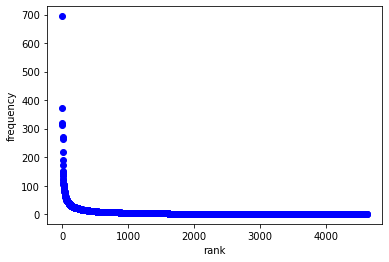

In [71]:
rank=0
for k, v in sort_dict_SW:
    rank+=1
    plt.plot(rank, words_dict_SW[k], 'bo')
plt.xlabel('rank')
plt.ylabel('frequency')
plt.show()

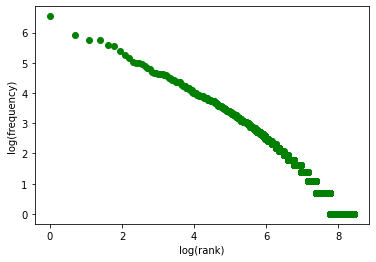

In [72]:
rank=0
for k, v in sort_dict_SW:
    rank+=1
    plt.plot(math.log(rank), math.log(v), 'go')
plt.xlabel('log(rank)')
plt.ylabel('log(frequency)')
plt.show()

In [77]:
len(text_del_SW3)

25504

In [78]:
text_freq = []
for t in text_del_SW3:
    temp=list(t)
    word_n = words_dict_SW[t[1]]
    temp.insert(4, word_n)
    text_freq.append(temp)

In [79]:
text_freq[:10]

[['Sentence: 1', '대체적', 'NNG', '100', 12],
 ['Sentence: 1', '환경', 'NNG', '100', 103],
 ['Sentence: 1', '좋', 'VA', '100', 694],
 ['Sentence: 1', '부서', 'NNG', '100', 44],
 ['Sentence: 1', '따르', 'VV', '100', 61],
 ['Sentence: 1', '다르', 'VV', '100', 54],
 ['Sentence: 1', '업무량', 'NNG', '100', 30],
 ['Sentence: 1', '몰리', 'VV', '100', 5],
 ['Sentence: 1', '야근', 'NNG', '100', 49],
 ['Sentence: 1', '필요', 'NNG', '100', 34]]

In [80]:
text_del_words = []
for t in text_freq:
    temp=list(t)
    if t[4]>2:
        text_del_words.append(temp)

In [81]:
len(text_del_words)

21765

In [82]:
sent_n = []
for i in range(len(text_del_words)):
    sent_n.append(re.sub(r'[^0-9]', '', text_del_words[i][0]))

In [83]:
X_text=[]
y_score=[]
sent=[]
for i in range(len(sent_n)-1):
    if (int(sent_n[i]) == int(sent_n[i+1])):
        sent.append(text_del_words[i][1])
    else:
        X_text.append(sent)
        y_score.append(text_del_words[i][3])        
        sent=[]

In [84]:
X_text[:10]

[['대체적', '환경', '좋', '부서', '따르', '다르', '업무량', '몰리', '야근', '필요', '경우'],
 ['정년', '확실히', '보장', '도서', '아니', '다양', '프로그램', '운영'],
 ['대한민국', '산업', '소수', '정예', '관리', '전문', '소속', '대한민국', '전체', '명'],
 ['수평적',
  '분위기',
  '좋',
  '상사',
  '눈치',
  '많이',
  '안',
  '보고',
  '휴가',
  '내가',
  '열심히',
  '외국인',
  '일하',
  '좋아하',
  '즐기',
  '저녁',
  '삶'],
 ['민원인', '많', '강도', '높'],
 ['활동', '좋', '지원'],
 ['관하', '수행', '정책', '크'],
 ['서울', '국제', '다루', '커리어', '쌓'],
 ['자유', '분위기', '보수적', '않', '상당히', '유연', '느낌'],
 ['제대로', '지키', '전반적', '모나', '없이', '다만', '민', '원인', '상대', '어', '디', '가나']]

In [85]:
y_score[:10]

['100', '100', '100', '100', '100', '100', '100', '100', '100', '100']

In [86]:
tokenizer = Tokenizer()
X_text_token = tokenizer.fit_on_texts(X_text)

In [87]:
X_text_token

In [88]:
print(len(tokenizer.word_index))
print(tokenizer.word_index)
# 빈도수가 높은 단어 순서대로 index 부여

1608
{'좋': 1, '없': 2, '일하': 3, '많': 4, '않': 5, '분위기': 6, '다니': 7, '배우': 8, '다양': 9, '문화': 10, '복지': 11, '경험': 12, '잘': 13, '연봉': 14, '크': 15, '안': 16, '대하': 17, '받': 18, '많이': 19, '성장': 20, '환경': 21, '아니': 22, '편하': 23, '경력': 24, '쌓': 25, '급여': 26, '안정적': 27, '높': 28, '너무': 29, '자유': 30, '나쁘': 31, '발전': 32, '편': 33, '계약': 34, '추천': 35, '매우': 36, '신입': 37, '업계': 38, '공무원': 39, '시간': 40, '그냥': 41, '체계': 42, '1': 43, '힘들': 44, '대우': 45, '따르': 46, '있음': 47, '조직': 48, '위하': 49, '강도': 50, '본인': 51, '하지만': 52, '개인': 53, '자기': 54, '워': 55, '가능': 56, '괜찮': 57, '개발': 58, '금융': 59, '없이': 60, '대표': 61, '다르': 62, '보수적': 63, '최고': 64, '야근': 65, '비하': 66, '나': 67, '부서': 68, '이상': 69, '능력': 70, '공기업': 71, '커리어': 72, '보험': 73, '알': 74, '더': 75, '사무실': 76, '돈': 77, '운영': 78, '정규직': 79, '은행': 80, '하나': 81, '오래': 82, '장점': 83, '정도': 84, '월급': 85, '다른': 86, '낮': 87, '보장': 88, '수평적': 89, '별로': 90, '무난': 91, '입사': 92, '그렇': 93, '위치': 94, '회계': 95, '바뀌': 96, '사회': 97, '가능성': 98, '생활': 99, '워라밸': 100, '때문': 10

In [89]:
threshold = 2
total_cnt = len(tokenizer.word_index)
rare_cnt=0 # threshold 보다 적은 빈도의 단어 수 count
total_freq = 0
rare_freq = 0

for k, v in tokenizer.word_counts.items():
    total_freq = total_freq + v
    
    if(v < threshold):
        rare_cnt = rare_cnt + 1
        rare_freq = rare_freq + v

In [90]:
print(total_cnt)
print(rare_cnt)


1608
21


In [91]:
vocab_size = total_cnt - rare_cnt + 1
print(vocab_size)

1588


In [92]:
len(X_text)

2551

In [93]:
tokenizer = Tokenizer(vocab_size)
tokenizer.fit_on_texts(X_text)
X_text = tokenizer.texts_to_sequences(X_text)

X_train, X_test, y_train, y_test = train_test_split(X_text, y_score, test_size=0.3, random_state=111)
#X_train = tokenizer.texts_to_sequences(X_text[:200])
#X_test = tokenizer.texts_to_sequences(X_text[201:])

In [94]:
len(X_train)

1785

In [95]:
X_test[:10]

[[19, 198, 9],
 [26, 324, 50, 87, 227, 88, 824, 3, 394],
 [692, 7, 236, 31, 5, 168, 250],
 [190,
  359,
  316,
  359,
  599,
  386,
  78,
  114,
  390,
  229,
  386,
  78,
  701,
  916,
  386,
  78,
  1235,
  193,
  917,
  352],
 [156, 557, 34, 352, 917],
 [648, 222, 873, 29, 1266, 142, 532, 1047],
 [276, 298, 124, 125, 241, 1329, 22, 28, 293, 187],
 [409, 851, 486, 51, 718, 30],
 [338,
  233,
  35,
  789,
  107,
  97,
  563,
  43,
  322,
  229,
  268,
  631,
  104,
  1484,
  180,
  41,
  400],
 [407, 235, 18, 1393]]

In [96]:
y_test[:10]

['100', '100', '0', '0', '100', '0', '0', '100', '0', '100']

In [97]:
drop_train = [index for index, sentence in enumerate(X_train) if len(sentence) < 1]

In [98]:
drop_train # 비어 있는 샘플 확인

[183, 494, 1088, 1596]

In [99]:
for index in drop_train:
    del X_train[index]
    del y_train[index]
#X_train = np.delete(X_train, drop_train, axis=0)
#y_train = np.delete(y_train, drop_train, axis=0)

In [100]:
len(X_train)

1781

In [101]:
X_train

[[30, 6, 183, 1483, 2, 41, 308, 1481, 1047],
 [63, 5],
 [656, 265, 714, 1290, 822, 63, 5, 11, 320, 6],
 [173, 6, 31, 5, 14, 9],
 [1450, 59, 940, 256, 1450, 518, 78, 694, 1, 576, 1450, 22],
 [836, 1133, 1029, 1, 7],
 [1176, 46],
 [848, 834, 1028, 40, 86],
 [1293, 15, 2, 1050, 7],
 [43, 755, 494, 908, 69],
 [937, 32, 164, 96, 307, 70, 464, 420, 401],
 [78, 123, 717],
 [522, 275, 273],
 [3, 1, 347, 214, 31, 5, 8, 161, 75, 212],
 [41, 1157, 470, 776, 58, 8],
 [372, 29, 1086, 259, 1173, 124, 125, 867, 158, 158, 46, 1132],
 [1284, 1556],
 [133, 5, 14, 87, 433, 168, 84, 632, 47, 55],
 [20, 98, 2, 164, 767, 409, 454, 22, 533, 636, 1056],
 [89, 10, 110, 88, 660, 102, 197],
 [280, 705, 491, 280, 705, 574, 697, 44, 894, 450, 406, 108, 22, 409],
 [23, 6, 19],
 [255, 741, 984, 295, 427, 226],
 [1, 6, 65, 364],
 [37, 94, 7, 44, 4, 302, 12, 20, 47, 37, 32, 133],
 [3, 23, 679, 176, 56, 370, 264, 435],
 [63, 466, 48, 28, 118, 14, 27, 20, 203],
 [442, 1, 71, 23, 1286, 40, 569, 40],
 [53,
  569,
  718,
 

리뷰의 최대 길이 : 136
리뷰의 평균 길이 : 7.52835485682201


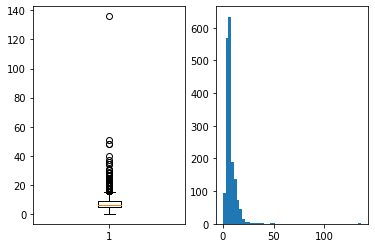

In [102]:
len_result = [len(s) for s in X_train]

print('리뷰의 최대 길이 : {}'.format(np.max(len_result)))
print('리뷰의 평균 길이 : {}'.format(np.mean(len_result)))

plt.subplot(1,2,1)
plt.boxplot(len_result)
plt.subplot(1,2,2)
plt.hist(len_result, bins=50)
plt.show()

In [103]:
max_len=20

In [104]:
def below_threshold_len(max_len, nested_list):
    count = 0
    for sentence in nested_list:
        if(len(sentence) <= max_len):
            count = count + 1
    print('전체 샘플 중 길이가 %s 이하인 샘플의 비율: %s'%(max_len, (count / len(nested_list))*100))

In [105]:
below_threshold_len(max_len, X_train)

전체 샘플 중 길이가 20 이하인 샘플의 비율: 98.03481190342505


In [106]:
unique_elements, counts_elements = np.unique(y_train, return_counts=True)
print("각 레이블에 대한 빈도수:")
print(np.asarray((unique_elements, counts_elements)))

각 레이블에 대한 빈도수:
[['0' '100']
 ['899' '882']]


In [107]:
word_to_index = tokenizer.word_index
index_to_word = {}
for key, value in word_to_index.items():
    index_to_word[value+3] = key

In [108]:
print('빈도수 상위 1등 단어 : {}'.format(index_to_word[4]))

빈도수 상위 1등 단어 : 좋


In [ ]:
# (index 변환 전) X_train[0] 한국어 단어 표시
for index, token in enumerate(("<pad>", "<sos>", "<unk>")):
    index_to_word[index] = token

print(' '.join([index_to_word[index] for index in X_train[0]]))

In [115]:
X_train = np.array(X_train)
y_train = np.array(y_train)
X_test = np.array(X_test)
y_test = np.array(y_test)

In [116]:
X_train = pad_sequences(X_train, maxlen=max_len)
X_test = pad_sequences(X_test, maxlen=max_len)

In [117]:
print(X_train.shape)
print(y_train.shape)
print(X_test.shape)
print(y_test.shape)

(1781, 20)
(1781,)
(766, 20)
(766,)


In [121]:
# Naive bayes training
nb = MultinomialNB()
nb.fit(X_train, y_train)
preds = nb.predict(X_test)
print(confusion_matrix(y_test, preds))
print('\n')
print(classification_report(y_test, preds))

[[292 103]
 [290  81]]


              precision    recall  f1-score   support

           0       0.50      0.74      0.60       395
         100       0.44      0.22      0.29       371

    accuracy                           0.49       766
   macro avg       0.47      0.48      0.44       766
weighted avg       0.47      0.49      0.45       766



In [122]:
# Logistic Regression training

logreg = LogisticRegression(solver='liblinear')
logreg.fit(X_train, y_train)
# Logistic Regression prediction
y_pred_logreg = logreg.predict(X_test)
print(classification_report(y_test, y_pred_logreg))

              precision    recall  f1-score   support

           0       0.50      0.54      0.52       395
         100       0.46      0.41      0.43       371

    accuracy                           0.48       766
   macro avg       0.48      0.48      0.48       766
weighted avg       0.48      0.48      0.48       766



In [ ]:
svc = SVC(gamma='scale', kernel='linear')
svc.fit(X_train, y_train)
y_pred_svc = svc.predict(X_test)
print(classification_report(y_test, y_pred_svc))


In [123]:
ANN = MLPClassifier(solver='lbfgs', alpha=1, hidden_layer_sizes=(20, 2), random_state=1)
ANN.fit(X_train, y_train)
y_pred_ANN = ANN.predict(X_test)
print(classification_report(y_test, y_pred_ANN))

              precision    recall  f1-score   support

           0       0.52      1.00      0.68       395
         100       0.00      0.00      0.00       371

    accuracy                           0.52       766
   macro avg       0.26      0.50      0.34       766
weighted avg       0.27      0.52      0.35       766



c:\users\sj\appdata\local\programs\python\python39\lib\site-packages\sklearn\metrics\_classification.py:1221: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
